In [1]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from monai.transforms import (
    Compose,
    ScaleIntensityRanged,
    Resized,
    NormalizeIntensityd,
    ToTensord
)
from monai.networks.nets import SegResNet
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from monai.networks.layers import Norm
import matplotlib.colors as mcolors
from torch.amp import autocast, GradScaler
from scipy.ndimage import binary_erosion, distance_transform_edt


In [2]:
# Define the device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
# Define functions to calculate sizes, volumes, and borders
def calculate_sizes(segmentation_mask, num_classes):
    sizes = []
    for cls in range(1, num_classes):  # Exclude the background class (0)
        sizes.append(np.sum(segmentation_mask == cls))
    return sizes

In [4]:
def calculate_volumes(segmentation_batch, num_classes):
    volumes = []
    for cls in range(1, num_classes):  # Exclude the background class (0)
        volumes.append(np.sum(segmentation_batch == cls))
    return volumes

In [5]:
def calculate_borders(segmentation_mask, num_classes):
    borders = []
    for cls in range(1, num_classes):  # Exclude the background class (0)
        class_mask = (segmentation_mask == cls)
        eroded_mask = binary_erosion(class_mask)
        border_mask = class_mask ^ eroded_mask  # Use XOR to find the border
        borders.append(np.sum(border_mask))
    return borders


In [6]:
def calculate_size_errors(ground_truth_mask, predicted_mask, num_classes):
    ground_truth_sizes = calculate_sizes(ground_truth_mask, num_classes)
    predicted_sizes = calculate_sizes(predicted_mask, num_classes)
    
    # Calculate absolute error between ground truth and predicted sizes
    size_errors = np.abs(np.array(predicted_sizes) - np.array(ground_truth_sizes))
    
    return size_errors
    
def calculate_volume_errors(ground_truth_mask, predicted_mask, num_classes):
    ground_truth_volumes = calculate_volumes(ground_truth_mask, num_classes)
    predicted_volumes = calculate_volumes(predicted_mask, num_classes)
    
    # Calculate absolute error between ground truth and predicted volumes
    volume_errors = np.abs(np.array(predicted_volumes) - np.array(ground_truth_volumes))
    
    return volume_errors
   
def calculate_border_errors(ground_truth_mask, predicted_mask, num_classes):
    ground_truth_borders = calculate_borders(ground_truth_mask, num_classes)
    predicted_borders = calculate_borders(predicted_mask, num_classes)
    
    # Calculate absolute error between ground truth and predicted borders
    border_errors = np.abs(np.array(predicted_borders) - np.array(ground_truth_borders))
    
    return border_errors

In [7]:
# Define EarlyStopping class
class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0, path='checkpoint.pt', trace_func=print):
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = float('inf')
        self.delta = delta
        self.path = path
        self.trace_func = trace_func

    def __call__(self, val_loss, model):
        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.verbose:
                self.trace_func(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decreases.'''
        if self.verbose:
            self.trace_func(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss


In [8]:
# Define helper functions
def load_nifti(file_path):
    return nib.load(file_path).get_fdata()

In [9]:
def get_file_list(directory):
    return [f for f in os.listdir(directory) if not f.startswith('.')]

In [10]:
def preprocess_image_2d(file_path, transforms):
    original_image = load_nifti(file_path)
    FLAIR_image = original_image[..., 0]  # Assuming the FLAIR channel is the first one

    slice_index = FLAIR_image.shape[-1] // 2
    FLAIR_slice = FLAIR_image[:, :, slice_index]

    data = {"image": np.expand_dims(FLAIR_slice, axis=0).astype(np.float32)}
    data = transforms(data)
    image = data["image"]
    return image


In [11]:
def preprocess_label_2d(file_path, transforms):
    label = load_nifti(file_path)

    slice_index = label.shape[-1] // 2
    label_slice = label[:, :, slice_index]

    data = {"label": np.expand_dims(label_slice, axis=0).astype(np.float32)}
    data = transforms(data)
    label = data["label"]
    return label


In [12]:
def pad_image(image, target_height, target_width, mode='constant', value=0):
    _, _, h, w = image.shape

    pad_h = max(0, target_height - h)
    pad_w = max(0, target_width - w)

    padding = (0, pad_w, 0, pad_h)  # Left, right, top, bottom

    padded_image = F.pad(image, padding, mode=mode, value=value)

    return padded_image


In [13]:
# Adaptive DDPM Noise Schedule
class AdaptiveDDPMNoiseSchedule:
    def __init__(self, num_steps, beta_start=0.001, beta_end=0.2, adapt_rate=0.2):
        self.num_steps = num_steps
        self.betas = np.linspace(beta_start, beta_end, num_steps)
        self.alphas = 1.0 - self.betas
        self.alpha_hats = np.cumprod(self.alphas)
        self.adapt_rate = adapt_rate

    def get_noise_level(self, step, current_loss=None, prev_loss=None):
        # Simple adaptive noise strategy based on loss change
        if current_loss is not None and prev_loss is not None:
            if current_loss > prev_loss:
                adapt_factor = (1 + self.adapt_rate)
            else:
                adapt_factor = (1 - self.adapt_rate)
        else:
            adapt_factor = 1.0

        return min(self.betas[step] * adapt_factor, 1.0)

In [14]:
# DDPM Forward Process with Adaptive Noise
def ddpm_forward_process_adaptive(image, noise_schedule, num_steps, losses=None):
    noised_images = []
    noises = []
    current_image = image.clone()

    for step in range(num_steps):
        # Handle the case when losses are not yet available
        if losses and len(losses) > 0:
            current_loss = losses[-1]  # Use the last loss in the list
            prev_loss = losses[-2] if len(losses) > 1 else None  # Handle the case where only one loss is available
        else:
            current_loss, prev_loss = None, None

        beta_t = noise_schedule.get_noise_level(step, current_loss, prev_loss)
        alpha_hat = torch.tensor(noise_schedule.alpha_hats[step], device=current_image.device, dtype=torch.float32)
        noise = torch.randn_like(current_image)
        noised_image = torch.sqrt(alpha_hat) * current_image + torch.sqrt(1 - alpha_hat) * noise
        noised_images.append(noised_image)
        noises.append(noise)
        current_image = noised_image

    return noised_images, noises

In [15]:
def ddpm_reverse_process(model, final_noised_image, noises, noise_schedule):
    reversed_images = []
    num_steps = len(noises)
    
    # Ensure the final_noised_image is a tensor
    if not isinstance(final_noised_image, torch.Tensor):
        reversed_image = torch.tensor(final_noised_image, device=device) 
    else:
        reversed_image = final_noised_image.clone()

    for step in range(num_steps - 1, -1, -1):
        beta_t = noise_schedule.betas[step]
        alpha_hat_t = noise_schedule.alpha_hats[step]
        noise = noises[step]

        # Ensure the input to the model has 1 channel
        if reversed_image.shape[1] > 1:
            reversed_image = reversed_image[:, :1, :, :]  # Keep only the first channel

        input_tensor = reversed_image.to(device)
        predicted_noise = model(input_tensor).detach()

        # Ensure alpha_hat_t is a tensor as well
        if not isinstance(alpha_hat_t, torch.Tensor):
            alpha_hat_t = torch.tensor(alpha_hat_t, device=device, dtype=torch.float32)

        reversed_image = (reversed_image - beta_t * predicted_noise) / torch.sqrt(alpha_hat_t)
        reversed_images.insert(0, reversed_image.clone())

    return reversed_images

In [16]:
def calculate_accuracy(predicted_output, target_tensor):
    predicted_classes = torch.argmax(predicted_output, dim=1)
    correct_predictions = (predicted_classes == target_tensor)
    total_predictions = correct_predictions.numel()  # Total number of predictions
    correct_predictions = correct_predictions.sum().item()  # Number of correct predictions

    accuracy = correct_predictions / total_predictions

    return accuracy

In [17]:
def calculate_dice_per_class(predicted_output, target_tensor, exclude_background=True):
    predicted_classes = torch.argmax(predicted_output, dim=1)
    predicted_one_hot = F.one_hot(predicted_classes, num_classes=predicted_output.shape[1]).permute(0, 3, 1, 2).float()
    target_one_hot = F.one_hot(target_tensor, num_classes=predicted_output.shape[1]).permute(0, 3, 1, 2).float()

    dice_scores = {}
    num_classes = predicted_output.shape[1]
    start_class = 1 if exclude_background else 0

    for c in range(start_class, num_classes):
        intersection = (predicted_one_hot[:, c, :, :] * target_one_hot[:, c, :, :]).sum(dim=(1, 2))
        union = predicted_one_hot[:, c, :, :].sum(dim=(1, 2)) + target_one_hot[:, c, :, :].sum(dim=(1, 2))
        dice_score = (2.0 * intersection + 1.0) / (union + 1.0)
        dice_scores[f"Class_{c}"] = dice_score.mean().item()

    return dice_scores

In [18]:
from scipy.ndimage import distance_transform_edt

def calculate_hd95_per_class(predicted_output, target_tensor, exclude_background=True):
    predicted_classes = torch.argmax(predicted_output, dim=1).cpu().numpy()
    target_classes = target_tensor.cpu().numpy()

    hd95_scores = {}
    num_classes = predicted_output.shape[1]
    start_class = 1 if exclude_background else 0

    for c in range(start_class, num_classes):
        # Get binary masks for the current class
        predicted_mask = (predicted_classes == c).astype(np.uint8)
        target_mask = (target_classes == c).astype(np.uint8)

        # Calculate distance transform for both the predicted and ground truth masks
        pred_dist_transform = distance_transform_edt(1 - predicted_mask)
        target_dist_transform = distance_transform_edt(1 - target_mask)

        # Calculate distances from predicted boundaries to ground truth boundaries
        pred_to_gt_distances = pred_dist_transform[target_mask == 1]
        gt_to_pred_distances = target_dist_transform[predicted_mask == 1]

        # Combine both distances
        all_distances = np.concatenate([pred_to_gt_distances, gt_to_pred_distances])

        if len(all_distances) == 0:
            hd95_score = 0.0  # Handle cases where there are no boundaries
        else:
            # Calculate the 95th percentile of the distances
            hd95_score = np.percentile(all_distances, 95)

        hd95_scores[f"Class_{c}"] = hd95_score

    return hd95_scores


In [19]:
def visualize_diffusion_process(noised_images, reversed_images, num_steps):
    num_images = min(len(noised_images[0]), len(reversed_images[0]))
    num_steps_to_display = 6  # Adjust this based on how many steps you want to visualize

    step_indices = np.linspace(0, num_steps - 1, num_steps_to_display, dtype=int)

    fig, axs = plt.subplots(num_images, 2 * num_steps_to_display, figsize=(20, num_images * 4))

    if num_images == 1:
        axs = [axs]  # Ensure axs is iterable when there's only one image
    else:
        axs = axs.reshape(num_images, 2 * num_steps_to_display)

    for i in range(num_images):
        for j, step in enumerate(step_indices):
            if step < len(noised_images):
                img_noise = noised_images[step][i, 0, :, :].cpu().numpy()  # Show i-th image in batch
                axs[i][j].imshow(img_noise, cmap='gray')
                axs[i][j].set_title(f"Noise {step + 1}")
                axs[i][j].axis('off')

            if step < len(reversed_images):
                img_rev = reversed_images[step][i, 0, :, :].cpu().numpy()  # Show i-th image in batch
                axs[i][j + num_steps_to_display].imshow(img_rev, cmap='gray')
                axs[i][j + num_steps_to_display].set_title(f"Reverse {step + 1}")
                axs[i][j + num_steps_to_display].axis('off')

    plt.show()

In [20]:
def visualize_segmentation(ground_truth, predicted_output):
    num_images = ground_truth.shape[0]  # Number of images in the batch
    fig, axs = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))
    if num_images == 1:
        axs = [axs]  # Ensure axs is iterable when there's only one image
    else:
        axs = axs.reshape(num_images, 2)

    tumor_cmap = mcolors.ListedColormap(['black', 'red', 'green', 'blue'])

    for i in range(num_images):
        ground_truth_np = ground_truth[i].squeeze().cpu().numpy()
        if ground_truth_np.ndim == 3:
            ground_truth_np = ground_truth_np[0, :, :]

        axs[i][0].imshow(ground_truth_np, cmap=tumor_cmap, vmin=0, vmax=3)
        axs[i][0].set_title("Ground Truth Segmentation")
        axs[i][0].axis('off')

        predicted_output_slice = np.argmax(predicted_output[i], axis=0)  # Show i-th image in batch
        axs[i][1].imshow(predicted_output_slice[:, :], cmap=tumor_cmap, vmin=0, vmax=3)
        axs[i][1].set_title("Predicted Segmentation")
        axs[i][1].axis('off')

    plt.show()


In [21]:
# Implementing Focal Loss
class FocalLoss(torch.nn.Module):
    def __init__(self, gamma=2.0, alpha=0.25):
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        self.alpha = alpha

    def forward(self, inputs, targets):
        BCE_loss = F.cross_entropy(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss)  # Prevents nans when probability is 0
        F_loss = self.alpha * (1 - pt) ** self.gamma * BCE_loss
        return F_loss.mean()

In [22]:
# # Implementing Dice Loss
# class DiceLoss(torch.nn.Module):
#     def __init__(self, smooth=1.0):
#         super(DiceLoss, self).__init__()
#         self.smooth = smooth

#     def forward(self, inputs, targets):
#         inputs = torch.softmax(inputs, dim=1)
#         targets_one_hot = F.one_hot(targets, num_classes=inputs.shape[1]).permute(0, 3, 1, 2).float()

#         intersection = (inputs * targets_one_hot).sum(dim=(2, 3))
#         union = inputs.sum(dim=(2, 3)) + targets_one_hot.sum(dim=(2, 3))

#         dice_score = (2.0 * intersection + self.smooth) / (union + self.smooth)
#         return 1 - dice_score.mean()


In [23]:
# # Implementing Boundary Loss based on Hausdorff Distance
# class HausdorffDistanceLoss(torch.nn.Module):
#     def __init__(self, alpha=2.0):
#         super(HausdorffDistanceLoss, self).__init__()
#         self.alpha = alpha

#     def forward(self, inputs, targets):
#         inputs = torch.argmax(inputs, dim=1).float()
#         targets = targets.float()

#         input_dist_map = torch.from_numpy(distance_transform_edt(inputs.cpu().numpy())).to(inputs.device)
#         target_dist_map = torch.from_numpy(distance_transform_edt(targets.cpu().numpy())).to(targets.device)

#         boundary_loss = F.mse_loss(input_dist_map, target_dist_map)

#         return boundary_loss

In [24]:
# # Combined Loss Function
# class CombinedBoundaryLoss(torch.nn.Module):
#     def __init__(self, focal_weight=1.0, dice_weight=1.0, boundary_weight=1.0, gamma=2.0, alpha=0.25):
#         super(CombinedBoundaryLoss, self).__init__()
#         self.focal_loss = FocalLoss(gamma=gamma, alpha=alpha)
#         self.dice_loss = DiceLoss()
#         self.boundary_loss = HausdorffDistanceLoss()
#         self.focal_weight = focal_weight
#         self.dice_weight = dice_weight
#         self.boundary_weight = boundary_weight

#     def forward(self, inputs, targets):
#         focal_loss_value = self.focal_loss(inputs, targets)
#         dice_loss_value = self.dice_loss(inputs, targets)
#         boundary_loss_value = self.boundary_loss(inputs, targets)

#         combined_loss = (
#             self.focal_weight * focal_loss_value +
#             self.dice_weight * dice_loss_value +
#             self.boundary_weight * boundary_loss_value
#         )

#         return combined_loss

In [25]:
# Define num_classes based on the model's output channels
num_classes = 4  # Adjust according to your model's out_channels


In [26]:
# Directories for training data
data_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/imagesTr'
label_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/labelsTr'


In [27]:
image_transforms = Compose([
    ScaleIntensityRanged(keys=["image"], a_min=0, a_max=2000, b_min=0.0, b_max=1.0, clip=True),
    Resized(keys=["image"], spatial_size=(128, 128), mode='bilinear'),
    NormalizeIntensityd(keys="image", nonzero=False, channel_wise=True),
    ToTensord(keys=["image"])
])

label_transforms = Compose([
    Resized(keys=["label"], spatial_size=(128, 128), mode='nearest'),
    ToTensord(keys=["label"])
])

In [28]:
# Get file lists and select only the images for training
train_image_files = get_file_list(data_dir)
train_label_files = get_file_list(label_dir)


In [29]:
# Load and preprocess images and labels for train
batch_images = []
batch_labels = []


In [30]:
for img_file, lbl_file in zip(train_image_files, train_label_files):
    image_file_path = os.path.join(data_dir, img_file)
    label_file_path = os.path.join(label_dir, lbl_file)

    image = preprocess_image_2d(image_file_path, image_transforms)
    batch_images.append(image)

    label = preprocess_label_2d(label_file_path, label_transforms)
    batch_labels.append(label)



In [31]:
batch_images = torch.stack(batch_images, dim=0).to(device)
batch_labels = torch.stack(batch_labels, dim=0).to(device)

In [32]:
# Directories for validation data
val_data_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/imagesVal'
val_label_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/labelsVal'


In [33]:
# Get file lists and select only the first 20 images for validation
val_image_files = get_file_list(val_data_dir)
val_label_files = get_file_list(val_label_dir)


In [34]:
# Load and preprocess the validation images and labels
val_batch_images = []
val_batch_labels = []


In [35]:
for img_file, lbl_file in zip(val_image_files, val_label_files):
    image_file_path = os.path.join(val_data_dir, img_file)
    label_file_path = os.path.join(val_label_dir, lbl_file)

    image = preprocess_image_2d(image_file_path, image_transforms)
    val_batch_images.append(image)

    label = preprocess_label_2d(label_file_path, label_transforms)
    val_batch_labels.append(label)


In [36]:
val_batch_images = torch.stack(val_batch_images, dim=0).to(device)
val_batch_labels = torch.stack(val_batch_labels, dim=0).to(device)

In [37]:
# Pad all images and labels
input_slice_padded = pad_image(batch_images, target_height=128, target_width=128)
target_tensor_padded = pad_image(batch_labels, target_height=128, target_width=128).squeeze(1).long()


In [38]:
val_input_slice_padded = pad_image(val_batch_images, target_height=128, target_width=128)
val_target_tensor_padded = pad_image(val_batch_labels, target_height=128, target_width=128).squeeze(1).long()

In [39]:
num_steps = 50
adaptive_noise_schedule = AdaptiveDDPMNoiseSchedule(num_steps)
noised_images, noises = ddpm_forward_process_adaptive(batch_images, adaptive_noise_schedule, num_steps)


In [40]:
final_noised_image = noised_images[-1]
print(f"Final noised image shape: {final_noised_image.shape}")

Final noised image shape: torch.Size([400, 1, 128, 128])


In [41]:
# Example: SegResNet architecture that matches the pre-trained model
model = SegResNet(
    spatial_dims=2,
    in_channels=1,
    out_channels=4,  # Adjust according to the pre-trained model
    norm=Norm.BATCH,
    blocks_down=[1, 2, 2, 4],  # Ensure these match the pre-trained model
    blocks_up=[1, 2, 2],
    init_filters=32
).to(device)


In [42]:
# Load the pre-trained model weights
model_path = 'best_model_segnet.pth'
model.load_state_dict(torch.load(model_path, map_location=device))
print("Loaded pre-trained model weights from", model_path)

Loaded pre-trained model weights from best_model_segnet.pth


C:\Users\td362\AppData\Local\Temp\ipykernel_17044\1397307438.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=de

In [43]:
criterion =  FocalLoss(gamma=2.0, alpha=0.25)
optimizer = Adam(model.parameters(), lr=1e-4)
scaler = GradScaler()
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=10, verbose=True)  # Learning rate scheduler
early_stopping = EarlyStopping(patience=10, verbose=True)  # Early stopping


C:\ProgramData\anaconda3\envs\new_env\Lib\site-packages\torch\optim\lr_scheduler.py:60: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [44]:
# # Initialize lists to store losses, accuracies, and HD95 values
# losses = []
# accuracies = []
# val_losses = []
# val_accuracies = []
# val_hd95_list = []  # Initialize this list before the loop

In [45]:
num_epochs = 500

In [46]:

# Function for training one epoch with the FocalLoss
def train_one_epoch(model, optimizer, criterion, input_tensor, target_tensor, scaler):
    model.train()

    optimizer.zero_grad()
    with autocast(device_type='cuda' if torch.cuda.is_available() else 'cpu'):  # Specify device_type explicitly
        output = model(input_tensor)
        loss = criterion(output, target_tensor)

    scaler.scale(loss).backward()
    scaler.step(optimizer)
    scaler.update()

    return loss.item()



In [47]:
# Function for validating one epoch with the FocalLoss
def validate_one_epoch(model, criterion, val_input_tensor, val_target_tensor):
    model.eval()
    with torch.no_grad():
        output = model(val_input_tensor)
        loss = criterion(output, val_target_tensor)
        accuracy = calculate_accuracy(output, val_target_tensor)
        hd95_scores = calculate_hd95_per_class(output, val_target_tensor, exclude_background=True)
        
        # Calculate overall HD95 (e.g., average across all classes)
        overall_hd95 = np.mean(list(hd95_scores.values()))

    return loss.item(), accuracy, overall_hd95, hd95_scores


In [48]:
# Initialize lists to store losses, accuracies, and HD95 values
losses = []
accuracies = []
val_losses = []
val_accuracies = []
val_hd95_list = []
val_hd95_scores_list = []  # To store detailed per-class HD95 scores

for epoch in range(num_epochs):
    # Generate adaptive noised images
    noised_images, noises = ddpm_forward_process_adaptive(batch_images, adaptive_noise_schedule, num_steps, losses)
    final_noised_image = noised_images[-1]

    # Train the model with adaptive noise
    loss = train_one_epoch(model, optimizer, criterion, input_slice_padded, target_tensor_padded, scaler)

    with torch.no_grad():
        predicted_output = model(input_slice_padded)

    accuracy = calculate_accuracy(predicted_output, target_tensor_padded)

    losses.append(loss)
    accuracies.append(accuracy)

    # Validation step
    val_loss, val_accuracy, overall_hd95, val_hd95_scores = validate_one_epoch(
        model, criterion, val_input_slice_padded, val_target_tensor_padded
    )
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    val_hd95_list.append(overall_hd95)
    val_hd95_scores_list.append(val_hd95_scores)

    # Step the scheduler based on validation loss
    scheduler.step(val_loss)

    print(f"Epoch {epoch + 1}/{num_epochs}, "
          f"Loss: {loss:.4f}, Accuracy: {accuracy * 100:.2f}%, "
          f"Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy * 100:.2f}%, "
          f"Val HD95 (Overall): {overall_hd95:.4f}")

    # Optionally print detailed per-class HD95 scores
    for class_id, hd95_score in val_hd95_scores.items():
        print(f"Val HD95 for {class_id}: {hd95_score:.4f}")

    # Check early stopping condition
    early_stopping(val_loss, model)
    if early_stopping.early_stop:
        print("Early stopping")
        break


Epoch 1/500, Loss: 0.0157, Accuracy: 98.16%, Val Loss: 0.0229, Val Accuracy: 97.58%, Val HD95 (Overall): 22.2757
Val HD95 for Class_1: 5.6569
Val HD95 for Class_2: 29.0861
Val HD95 for Class_3: 32.0843
Validation loss decreased (inf --> 0.022899).  Saving model ...
Epoch 2/500, Loss: 0.0104, Accuracy: 98.07%, Val Loss: 0.0160, Val Accuracy: 97.75%, Val HD95 (Overall): 16.7354
Val HD95 for Class_1: 4.4721
Val HD95 for Class_2: 24.2631
Val HD95 for Class_3: 21.4709
Validation loss decreased (0.022899 --> 0.015975).  Saving model ...
Epoch 3/500, Loss: 0.0079, Accuracy: 97.93%, Val Loss: 0.0116, Val Accuracy: 97.82%, Val HD95 (Overall): 12.7825
Val HD95 for Class_1: 4.0000
Val HD95 for Class_2: 20.8567
Val HD95 for Class_3: 13.4907
Validation loss decreased (0.015975 --> 0.011643).  Saving model ...
Epoch 4/500, Loss: 0.0071, Accuracy: 97.95%, Val Loss: 0.0093, Val Accuracy: 97.81%, Val HD95 (Overall): 10.0492
Val HD95 for Class_1: 4.0000
Val HD95 for Class_2: 16.2481
Val HD95 for Class_3

In [49]:
# After the training loop, save the trained model
model_save_path = 'trained_segmentation_focal_model.pth'
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")

Model saved to trained_segmentation_focal_model.pth


In [50]:
# Calculate Dice coefficient for training, for each class excluding the background
with torch.no_grad():
    train_predicted_output = model(input_slice_padded)
train_dice_scores = calculate_dice_per_class(train_predicted_output, target_tensor_padded, exclude_background=True)


In [51]:
# Calculate Dice coefficient for validation, for each class excluding the background
with torch.no_grad():
    val_predicted_output = model(val_input_slice_padded)
val_dice_scores = calculate_dice_per_class(val_predicted_output, val_target_tensor_padded, exclude_background=True)


In [52]:
# Print the Dice coefficients for each class
print("Train Dice Coefficients (excluding background):")
for cls, score in train_dice_scores.items():
    print(f"{cls}: {score:.4f}")

print("Validation Dice Coefficients (excluding background):")
for cls, score in val_dice_scores.items():
    print(f"{cls}: {score:.4f}")

Train Dice Coefficients (excluding background):
Class_1: 0.7927
Class_2: 0.5996
Class_3: 0.7755
Validation Dice Coefficients (excluding background):
Class_1: 0.7461
Class_2: 0.4960
Class_3: 0.7153


In [53]:
# Assuming you have a function called `calculate_hd95_per_class`
train_hd95_scores = calculate_hd95_per_class(train_predicted_output, target_tensor_padded, exclude_background=True)

# You can now use `train_hd95_scores` in your code similarly to how you used `train_iou_scores` and `train_f1_scores`.




In [54]:
# For example, printing the HD95 scores:
print("Training HD95 Scores (excluding background):")
for cls, score in train_hd95_scores.items():
    print(f"{cls}: {score:.4f}")
    
# # Print the HD95 scores for each class from the last epoch in the validation loop
# print("Validation HD95 Scores (excluding background):")
# if val_hd95_scores_list:
#     latest_val_hd95_scores = val_hd95_scores_list[-1]  # Get the latest dictionary of HD95 scores
#     for cls, score in latest_val_hd95_scores.items():
#         print(f"{cls}: {score:.4f}")
# else:
#     print("No HD95 scores available.")

print("Training HD95 Scores (excluding background):")
for cls, score in val_hd95_scores.items():
    print(f"{cls}: {score:.4f}")
    


Training HD95 Scores (excluding background):
Class_1: 1.0000
Class_2: 3.6056
Class_3: 1.4142
Training HD95 Scores (excluding background):
Class_1: 2.0000
Class_2: 8.2462
Class_3: 3.6056


In [55]:
# print("Train F1 Scores (excluding background):")
# for cls, score in train_f1_scores.items():
#     print(f"{cls}: {score:.4f}")

# print("Validation F1 Scores (excluding background):")
# for cls, f1_scores in val_f1_scores_list[-1].items():
#     print(f"{cls}: {f1_scores:.4f}")


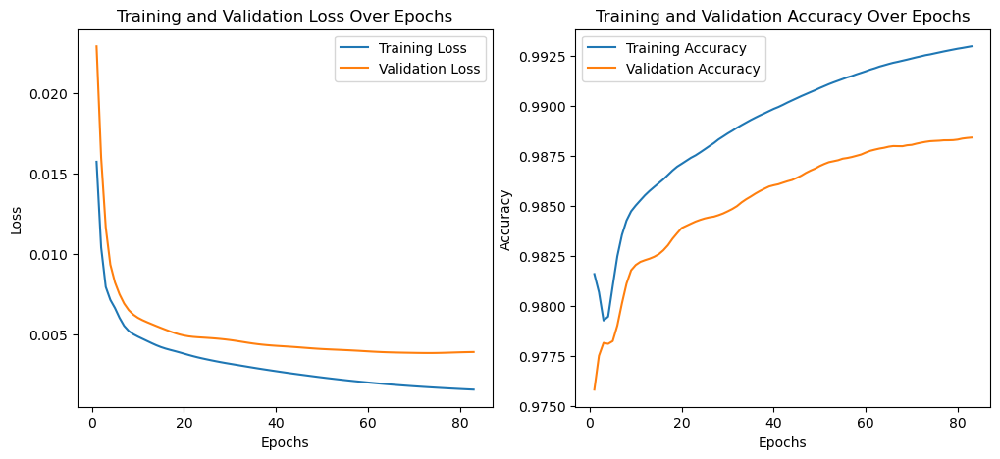

In [56]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(range(1, len(losses) + 1), losses, label='Training Loss')
plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(range(1, len(accuracies) + 1), accuracies, label='Training Accuracy')
plt.plot(range(1, len(val_accuracies) + 1), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy Over Epochs')
plt.legend()

plt.show()


In [57]:
# Convert predicted output back to a tensor before passing it to the reverse process
predicted_output_tensor = torch.tensor(val_predicted_output, device=device)


C:\Users\td362\AppData\Local\Temp\ipykernel_17044\727032862.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  predicted_output_tensor = torch.tensor(val_predicted_output, device=device)


In [58]:
# Perform forward diffusion on validation images (already done earlier)
noised_images_val, noises_val = ddpm_forward_process_adaptive(val_input_slice_padded, adaptive_noise_schedule, num_steps)

In [59]:
# Reverse the diffusion process
reversed_output_images_val = ddpm_reverse_process(model, predicted_output_tensor, noises_val, adaptive_noise_schedule)

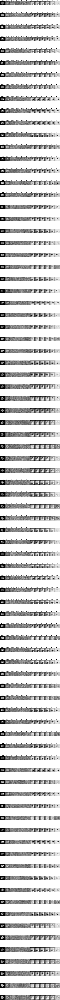

In [60]:
# Visualize the forward and reverse diffusion process for validation images
visualize_diffusion_process(noised_images_val, reversed_output_images_val, num_steps)

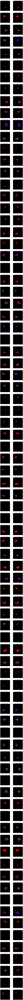

In [61]:
# Finally, visualize the segmentation results on the validation set
visualize_segmentation(val_target_tensor_padded, val_predicted_output.cpu().numpy())

In [62]:
# Calculate sizes, volumes, and borders for ground truth and predicted outputs
val_ground_truth_sizes = np.array([calculate_sizes(val_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(val_target_tensor_padded.shape[0])])
val_predicted_sizes = np.array([calculate_sizes(np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(val_predicted_output.shape[0])])

val_ground_truth_volumes = np.array([calculate_volumes(val_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(val_target_tensor_padded.shape[0])])
val_predicted_volumes = np.array([calculate_volumes(np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(val_predicted_output.shape[0])])

val_ground_truth_borders = np.array([calculate_borders(val_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(val_target_tensor_padded.shape[0])])
val_predicted_borders = np.array([calculate_borders(np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(val_predicted_output.shape[0])])


In [63]:
# Calculate volume and border errors for validation data
val_volume_errors = np.array([calculate_volume_errors(val_target_tensor_padded[i].cpu().numpy(), 
                                                     np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), 
                                                     num_classes) 
                              for i in range(val_target_tensor_padded.shape[0])])

val_border_errors = np.array([calculate_border_errors(val_target_tensor_padded[i].cpu().numpy(), 
                                                      np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), 
                                                      num_classes) 
                              for i in range(val_target_tensor_padded.shape[0])])

val_size_errors = np.array([calculate_size_errors(val_target_tensor_padded[i].cpu().numpy(), 
                                                      np.argmax(val_predicted_output[i].cpu().numpy(), axis=0), 
                                                      num_classes) 
                              for i in range(val_target_tensor_padded.shape[0])])

In [64]:

# # Define colors for each class
# colors = ['teal', 'tomato', 'navy']  # Replaced 'indigo' with 'teal'


#  # Adjust based on number of classes (excluding background)

In [65]:
# Class names corresponding to the classes
class_names = ['edema', 'non-enhancing tumor', 'enhancing tumour']

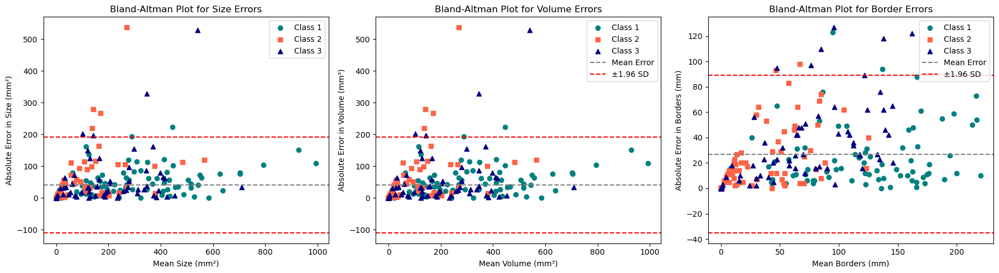

In [66]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming colors and markers are defined as follows
colors = ['teal', 'tomato', 'navy']  # Use the updated colors
markers = ['o', 's', '^']  # Circle, Square, and Triangle markers

plt.figure(figsize=(18, 5))

# Bland-Altman plot for size errors
plt.subplot(1, 3, 1)
for cls in range(num_classes - 1):
    size_mean = (val_ground_truth_sizes[:, cls] + val_predicted_sizes[:, cls]) / 2
    size_error = val_size_errors[:, cls]
    plt.scatter(size_mean, size_error, color=colors[cls], marker=markers[cls], label=f'Class {cls + 1}')
plt.axhline(np.mean(size_error), color='gray', linestyle='--')
plt.axhline(np.mean(size_error) + 1.96 * np.std(size_error), color='red', linestyle='--')
plt.axhline(np.mean(size_error) - 1.96 * np.std(size_error), color='red', linestyle='--')
plt.xlabel('Mean Size (mm²)')  # Assuming size is in square millimeters
plt.ylabel('Absolute Error in Size (mm²)')
plt.title('Bland-Altman Plot for Size Errors')
plt.legend()

# Bland-Altman plot for volume errors
plt.subplot(1, 3, 2)
for cls in range(num_classes - 1):
    volume_mean = (val_ground_truth_volumes[:, cls] + val_predicted_volumes[:, cls]) / 2
    volume_error = val_volume_errors[:, cls]
    plt.scatter(volume_mean, volume_error, color=colors[cls], marker=markers[cls], label=f'Class {cls + 1}')
plt.axhline(np.mean(volume_error), color='gray', linestyle='--', label='Mean Error')
plt.axhline(np.mean(volume_error) + 1.96 * np.std(volume_error), color='red', linestyle='--', label='±1.96 SD')
plt.axhline(np.mean(volume_error) - 1.96 * np.std(volume_error), color='red', linestyle='--')
plt.xlabel('Mean Volume (mm³)')  # Assuming volume is in cubic millimeters
plt.ylabel('Absolute Error in Volume (mm³)')
plt.title('Bland-Altman Plot for Volume Errors')
plt.legend()

# Bland-Altman plot for border errors
plt.subplot(1, 3, 3)
for cls in range(num_classes - 1):
    borders_mean = (val_ground_truth_borders[:, cls] + val_predicted_borders[:, cls]) / 2
    border_error = val_border_errors[:, cls]
    plt.scatter(borders_mean, border_error, color=colors[cls], marker=markers[cls], label=f'Class {cls + 1}')
plt.axhline(np.mean(border_error), color='gray', linestyle='--', label='Mean Error')
plt.axhline(np.mean(border_error) + 1.96 * np.std(border_error), color='red', linestyle='--', label='±1.96 SD')
plt.axhline(np.mean(border_error) - 1.96 * np.std(border_error), color='red', linestyle='--')
plt.xlabel('Mean Borders (mm)')  # Assuming border length is in millimeters
plt.ylabel('Absolute Error in Borders (mm)')
plt.title('Bland-Altman Plot for Border Errors')
plt.legend()

plt.tight_layout()
plt.show()


In [67]:
# Test the model on unseen test data and calculate metrics
test_data_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/imagesTs'
test_label_dir = 'C:/Users/td362/Downloads/Task01_BrainTumour/Task01_BrainTumour/labelsTs'

In [68]:
# Get file lists for test data
test_image_files = get_file_list(test_data_dir)
test_label_files = get_file_list(test_label_dir)

In [69]:
# Load and preprocess the test images and labels
test_batch_images = []
test_batch_labels = []


In [70]:
for img_file, lbl_file in zip(test_image_files, test_label_files):
    image_file_path = os.path.join(test_data_dir, img_file)
    label_file_path = os.path.join(test_label_dir, lbl_file)

    image = preprocess_image_2d(image_file_path, image_transforms)
    test_batch_images.append(image)

    label = preprocess_label_2d(label_file_path, label_transforms)
    test_batch_labels.append(label)


In [71]:
test_batch_images = torch.stack(test_batch_images, dim=0).to(device)
test_batch_labels = torch.stack(test_batch_labels, dim=0).to(device)


In [72]:
# Pad all test images and labels
test_input_slice_padded = pad_image(test_batch_images, target_height=128, target_width=128)
test_target_tensor_padded = pad_image(test_batch_labels, target_height=128, target_width=128).squeeze(1).long()

In [73]:
# Load the trained model for testing
model.load_state_dict(torch.load(model_save_path, map_location=device))
model.eval()

C:\Users\td362\AppData\Local\Temp\ipykernel_17044\1928240934.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_save_path, map_locati

SegResNet(
  (act_mod): ReLU(inplace=True)
  (convInit): Convolution(
    (conv): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (down_layers): ModuleList(
    (0): Sequential(
      (0): Identity()
      (1): ResBlock(
        (norm1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (norm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): ReLU(inplace=True)
        (conv1): Convolution(
          (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (conv2): Convolution(
          (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
      )
    )
    (1): Sequential(
      (0): Convolution(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      )
      (1): ResBlock(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affi

In [74]:
# After the training loop, save the trained model
model_save_path = 'trained_diffussion_model.pth'
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")


Model saved to trained_diffussion_model.pth


In [75]:
# Load the trained model for testing
model.load_state_dict(torch.load(model_save_path, map_location=device))
model.eval()

C:\Users\td362\AppData\Local\Temp\ipykernel_17044\1928240934.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_save_path, map_locati

SegResNet(
  (act_mod): ReLU(inplace=True)
  (convInit): Convolution(
    (conv): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (down_layers): ModuleList(
    (0): Sequential(
      (0): Identity()
      (1): ResBlock(
        (norm1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (norm2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): ReLU(inplace=True)
        (conv1): Convolution(
          (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (conv2): Convolution(
          (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
      )
    )
    (1): Sequential(
      (0): Convolution(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      )
      (1): ResBlock(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affi

In [76]:
# Predict on test data
with torch.no_grad():
    test_predicted_output = model(test_input_slice_padded)

# Predict on test data
with torch.no_grad():
    test_predicted_output = model(test_input_slice_padded)

# # Calculate Dice, IoU, F1-score, and Recall per class for test data
# test_iou_scores, test_f1_scores, test_recall_scores = calculate_iou_f1_recall(test_predicted_output, test_target_tensor_padded, num_classes)
test_dice_scores = calculate_dice_per_class(test_predicted_output, test_target_tensor_padded, exclude_background=True)
test_hd95_scores = calculate_hd95_per_class(test_predicted_output, test_target_tensor_padded, exclude_background=True)
# # Print metrics for test data
# print("Test IoU Scores (excluding background):")
# for cls, score in test_iou_scores.items():
#     print(f"{cls}: {score:.4f}")

# print("Test F1 Scores (excluding background):")
# for cls, score in test_f1_scores.items():
#     print(f"{cls}: {score:.4f}")

# print("Test Recall Scores (excluding background):")
# for cls, score in test_recall_scores.items():
#     print(f"{cls}: {score:.4f}")

print("Test Dice Scores (excluding background):")
for cls, score in test_dice_scores.items():
    print(f"{cls}: {score:.4f}")


print("Test hd95 Scores (excluding background):")
for cls, score in test_hd95_scores.items():
    print(f"{cls}: {score:.4f}")

Test Dice Scores (excluding background):
Class_1: 0.7503
Class_2: 0.5441
Class_3: 0.6918
Test hd95 Scores (excluding background):
Class_1: 2.2361
Class_2: 8.6023
Class_3: 4.1231


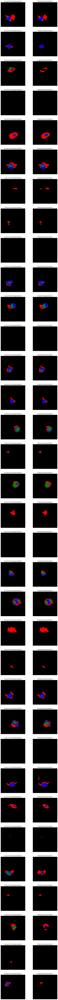

In [77]:
# Visualize the segmentation results on the test set
visualize_segmentation(test_target_tensor_padded, test_predicted_output.cpu().numpy())


In [78]:
# Calculate sizes, volumes, and borders for ground truth and predicted outputs in the test set
test_ground_truth_sizes = np.array([calculate_sizes(test_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(test_target_tensor_padded.shape[0])])
test_predicted_sizes = np.array([calculate_sizes(np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(test_predicted_output.shape[0])])

test_ground_truth_volumes = np.array([calculate_volumes(test_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(test_target_tensor_padded.shape[0])])
test_predicted_volumes = np.array([calculate_volumes(np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(test_predicted_output.shape[0])])

test_ground_truth_borders = np.array([calculate_borders(test_target_tensor_padded[i].cpu().numpy(), num_classes) for i in range(test_target_tensor_padded.shape[0])])
test_predicted_borders = np.array([calculate_borders(np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), num_classes) for i in range(test_predicted_output.shape[0])])

In [79]:
# Calculate volume and border errors for validation data
test_volume_errors = np.array([calculate_volume_errors(test_target_tensor_padded[i].cpu().numpy(), 
                                                     np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), 
                                                     num_classes) 
                              for i in range(test_target_tensor_padded.shape[0])])

test_border_errors = np.array([calculate_border_errors(test_target_tensor_padded[i].cpu().numpy(), 
                                                      np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), 
                                                      num_classes) 
                              for i in range(test_target_tensor_padded.shape[0])])

test_size_errors = np.array([calculate_size_errors(test_target_tensor_padded[i].cpu().numpy(), 
                                                      np.argmax(test_predicted_output[i].cpu().numpy(), axis=0), 
                                                      num_classes) 
                              for i in range(test_target_tensor_padded.shape[0])])

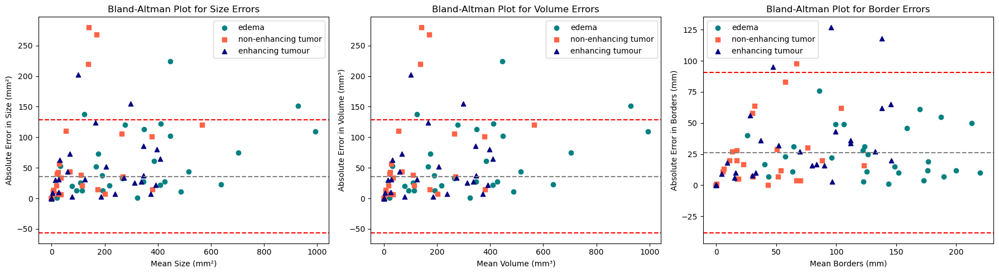

In [80]:
plt.figure(figsize=(18, 5))

# Bland-Altman plot for sizes
plt.subplot(1, 3, 1)
for cls in range(3):  # Loop through three classes
    size_mean = (test_ground_truth_sizes[:, cls] + test_predicted_sizes[:, cls]) / 2
    size_error = np.abs(test_predicted_sizes[:, cls] - test_ground_truth_sizes[:, cls])  # Use absolute error
    plt.scatter(size_mean, size_error, color=colors[cls], marker=markers[cls], label=class_names[cls])
plt.axhline(np.mean(size_error), color='gray', linestyle='--')
plt.axhline(np.mean(size_error) + 1.96 * np.std(size_error), color='red', linestyle='--')
plt.axhline(np.mean(size_error) - 1.96 * np.std(size_error), color='red', linestyle='--')
plt.xlabel('Mean Size (mm²)')  # Assuming size is in square millimeters
plt.ylabel('Absolute Error in Size (mm²)')
plt.title('Bland-Altman Plot for Size Errors')
plt.legend()

# Bland-Altman plot for volumes
plt.subplot(1, 3, 2)
for cls in range(3):  # Loop through three classes
    volume_mean = (test_ground_truth_volumes[:, cls] + test_predicted_volumes[:, cls]) / 2
    volume_error = np.abs(test_predicted_volumes[:, cls] - test_ground_truth_volumes[:, cls])  # Use absolute error
    plt.scatter(volume_mean, volume_error, color=colors[cls], marker=markers[cls], label=class_names[cls])
plt.axhline(np.mean(volume_error), color='gray', linestyle='--')
plt.axhline(np.mean(volume_error) + 1.96 * np.std(volume_error), color='red', linestyle='--')
plt.axhline(np.mean(volume_error) - 1.96 * np.std(volume_error), color='red', linestyle='--')
plt.xlabel('Mean Volume (mm³)')  # Assuming volume is in cubic millimeters
plt.ylabel('Absolute Error in Volume (mm³)')
plt.title('Bland-Altman Plot for Volume Errors')
plt.legend()

# Bland-Altman plot for borders
plt.subplot(1, 3, 3)
for cls in range(3):  # Loop through three classes
    borders_mean = (test_ground_truth_borders[:, cls] + test_predicted_borders[:, cls]) / 2
    borders_error = np.abs(test_predicted_borders[:, cls] - test_ground_truth_borders[:, cls])  # Use absolute error
    plt.scatter(borders_mean, borders_error, color=colors[cls], marker=markers[cls], label=class_names[cls])
plt.axhline(np.mean(borders_error), color='gray', linestyle='--')
plt.axhline(np.mean(borders_error) + 1.96 * np.std(borders_error), color='red', linestyle='--')
plt.axhline(np.mean(borders_error) - 1.96 * np.std(borders_error), color='red', linestyle='--')
plt.xlabel('Mean Borders (mm)')  # Assuming border length is in millimeters
plt.ylabel('Absolute Error in Borders (mm)')
plt.title('Bland-Altman Plot for Border Errors')
plt.legend()

plt.tight_layout()
plt.show()
